<a href="https://colab.research.google.com/github/IsHYuhi/BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image/blob/dev%2Ffix/demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# BEDSR-Net: A Deep Shadow Removal Network from a Single Document Image

## Yun-Hsuan Lin, Wen-Chin Chen, Yung-Yu Chuang, National Taiwan University,

### This colab. notebook contains the demo of unofficial reimplementation Lin's CVPR 2020 paper by [IsHYuhi](https://github.com/IsHYuhi). 
### More detail can be found in [Paper](https://openaccess.thecvf.com/content_CVPR_2020/html/Lin_BEDSR-Net_A_Deep_Shadow_Removal_Network_From_a_Single_Document_CVPR_2020_paper.html). For detail of the code, check the [repo](https://github.com/IsHYuhi/BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image).

\\

### Note
The results obtained from Jung dataset.

you can test your own images using my pretrained model, check the section  "Testing your own image" 

In [1]:
!pip install albumentations==0.4.6
!pip install matplotlib==3.4.2
!pip install torch==1.8.1

     |████████████████████████████████| 117 kB 10.5 MB/s 
     |████████████████████████████████| 948 kB 45.2 MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.6-py3-none-any.whl size=65172 sha256=d4118cbb16483317c850be6c3b7363289b161e6209a5b0cdf67297451300c83d
  Stored in directory: /root/.cache/pip/wheels/cf/34/0f/cb2a5f93561a181a4bcc84847ad6aaceea8b5a3127469616cc
Successfully built albumentations
  Attempting uninstall: imgaug
    Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Attempting uninstall: albumentations
    Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12
     |████████████████████████████████| 10.3 MB 12.6 MB/s 
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2


     |████████████████████████████████| 804.1 MB 2.6 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu111
    Uninstalling torch-1.9.0+cu111:
      Successfully uninstalled torch-1.9.0+cu111
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.10.0+cu111 requires torch==1.9.0, but you have torch 1.8.1 which is incompatible.
torchtext 0.10.0 requires torch==1.9.0, but you have torch 1.8.1 which is incompatible.


### Clone the repo.

In [1]:
! git clone https://github.com/IsHYuhi/BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image.git

Cloning into 'BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image'...
remote: Enumerating objects: 160, done.
remote: Counting objects: 100% (160/160), done.
remote: Compressing objects: 100% (99/99), done.
remote: Total 160 (delta 76), reused 116 (delta 50), pack-reused 0
Receiving objects: 100% (160/160), 54.32 MiB | 11.28 MiB/s, done.
Resolving deltas: 100% (76/76), done.


In [2]:
cd BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image

/content/BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image


In [3]:
! ls

configs  dataset     libs	 README.md  setup.cfg	       train_benet.py
csv	 demo.ipynb  pretrained  result     train_bedsrnet.py  utils


### Download dataset & pretrained model

the Jung dataset can be obtained from [this repository](https://github.com/seungjun45/Water-Filling). 

And, I remake the dataset following the procedure of BEDSR-Net paper.

In [4]:
! gdown https://drive.google.com/uc?id=1h56mAFboYwsUsSFCSM34HNekJFMtU1dg
! gdown https://drive.google.com/uc?id=192dqE4K6zuxD0tNre9UHDwu4YB4uxSnG
! gdown https://drive.google.com/uc?id=1NS4cxMwoGrWlHv6uyf8iVFAUN-xmw5vb

! unzip -u pretrained.zip && rm pretrained.zip
! unzip -u csv.zip && rm csv.zip
! unzip -u dataset.zip && rm dataset.zip

Downloading...
From: https://drive.google.com/uc?id=1h56mAFboYwsUsSFCSM34HNekJFMtU1dg
To: /content/BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image/pretrained.zip
100% 120M/120M [00:02<00:00, 57.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=192dqE4K6zuxD0tNre9UHDwu4YB4uxSnG
To: /content/BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image/dataset.zip
100% 38.4M/38.4M [00:00<00:00, 57.7MB/s]
Downloading...
From: https://drive.google.com/uc?id=1NS4cxMwoGrWlHv6uyf8iVFAUN-xmw5vb
To: /content/BEDSR-Net_A_Deep_Shadow_Removal_Network_from_a_Single_Document_Image/csv.zip
100% 4.50k/4.50k [00:00<00:00, 12.5MB/s]
Archive:  pretrained.zip
  inflating: pretrained/pretrained_benet.prm  
  inflating: pretrained/pretrained_d_srnet.prm  
  inflating: pretrained/pretrained_g_srnet.prm  
Archive:  csv.zip
  inflating: csv/Jung/train.csv      
  inflating: csv/Jung/test.csv       
  inflating: csv/Jung/val.csv        
Archive:  dataset.zip
   creating: dat

In [5]:

%matplotlib inline

import numpy as np
import torch
import cv2
import matplotlib.pyplot as plt
import numpy as np

from libs.models import get_model
from albumentations import (
    Compose,
    Normalize,
    Resize
)
from albumentations.pytorch import ToTensorV2

from utils.visualize import visualize, reverse_normalize
from libs.dataset import get_dataloader
from libs.loss_fn import get_criterion
from libs.helper_bedsrnet import do_one_iteration

In [12]:
def convert_show_image(tensor, idx=None):
    if tensor.shape[1]==3:
        img = reverse_normalize(tensor, mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    elif tensor.shape[1]==1:
        img = tensor*0.5+0.5

    if idx is not None:
        img = (img[idx].transpose(1, 2, 0)*255).astype(np.uint8)
    else:
        img = (img.squeeze(axis=0).transpose(1, 2, 0)*255).astype(np.uint8)

    return img

In [7]:
test_transform = Compose([Resize(1024, 768), Normalize(mean=(0.5, ), std=(0.5, )), ToTensorV2()])
test_loader = get_dataloader(
        "Jung",
        "bedsrnet",
        "test",
        batch_size=1,
        shuffle=False,
        num_workers=2,
        pin_memory=True,
        transform=test_transform,
    )

In [8]:
device = "cuda" if torch.cuda.is_available() else "cpu"
benet = get_model('cam_benet', in_channels=3, pretrained=True)
benet.model = benet.model.to(device)
srnet = get_model('srnet', pretrained=True)
generator, discriminator = srnet[0].to(torch.device('cpu')), srnet[1].to(torch.device('cpu'))
generator.eval()
discriminator.eval()
generator.to(device)
discriminator.to(device)
criterion = get_criterion("GAN", device)
lambda_dict = {"lambda1": 1.0, "lambda2": 0.01}

In [9]:
gts = []
preds = []
attmaps = []
bgcolors = []
psnrs = []
ssims = []
with torch.no_grad():
    for i, sample in enumerate(test_loader):
        print(sample["img_path"][0])
        _, _, _, input, gt, pred, attention_map, back_ground, psnr, ssim = do_one_iteration(sample, generator, discriminator, benet, criterion, device, "evaluate", lambda_dict)

        gts += list(gt)
        preds += list(pred)
        attmaps += list(attention_map)
        bgcolors += list(back_ground)
        psnrs.append(psnr)
        ssims.append(ssim)

./dataset/Jung/test/img/rect_1.jpg


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/module.py:795: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


./dataset/Jung/test/img/rect_10.jpg
./dataset/Jung/test/img/rect_11.jpg
./dataset/Jung/test/img/rect_12.jpg
./dataset/Jung/test/img/rect_13.jpg
./dataset/Jung/test/img/rect_14.jpg
./dataset/Jung/test/img/rect_15.jpg
./dataset/Jung/test/img/rect_16.jpg
./dataset/Jung/test/img/rect_17.jpg
./dataset/Jung/test/img/rect_18.jpg
./dataset/Jung/test/img/rect_19.jpg
./dataset/Jung/test/img/rect_2.jpg
./dataset/Jung/test/img/rect_20.jpg
./dataset/Jung/test/img/rect_3.jpg
./dataset/Jung/test/img/rect_4.jpg
./dataset/Jung/test/img/rect_5.jpg
./dataset/Jung/test/img/rect_6.jpg
./dataset/Jung/test/img/rect_7.jpg
./dataset/Jung/test/img/rect_8.jpg
./dataset/Jung/test/img/rect_9.jpg


In [10]:
print(f"psnr: {np.mean(psnrs)}")
print(f"ssim: {np.mean(ssims)}")

psnr: 21.499760873523616
ssim: 0.9022996470383321


# Results from the testing set of Jung.
left to right: input, ground trugh, removal image, background color, attention map from BE-Net

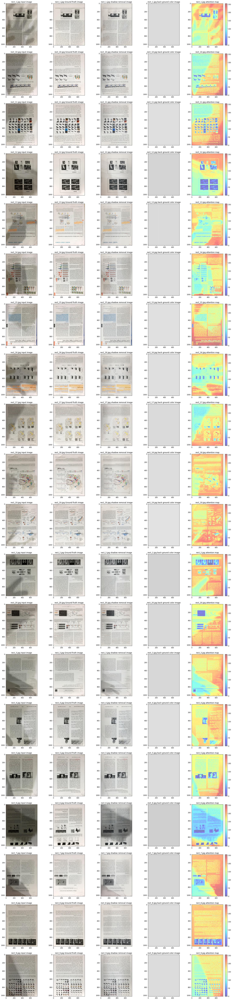

In [13]:
figure = plt.figure(figsize = (9*3, 2*3*len(test_loader)))

for idx, sample in enumerate(test_loader):
    img_path = sample['img_path'][0].split('/')[-1]

    plt.subplot(len(test_loader), 5, idx*5+1)
    plt.title(img_path + ' input image')
    plt.imshow(convert_show_image(sample["img"].clone().cpu().numpy()))

    plt.subplot(len(test_loader), 5, idx*5+2)
    plt.title(img_path + ' Ground-Truth image')
    plt.imshow(convert_show_image(np.array(gts), idx=idx))

    plt.subplot(len(test_loader), 5,  idx*5+3)
    plt.title(img_path + ' shadow removal image')
    plt.imshow(convert_show_image(np.array(preds), idx=idx))

    plt.subplot(len(test_loader), 5, idx*5+4)
    plt.title(img_path + ' back ground color image')
    plt.imshow(convert_show_image(np.array(bgcolors), idx=idx))

    plt.subplot(len(test_loader), 5, idx*5+5)
    plt.title(img_path + ' attention map')
    plt.imshow(convert_show_image(np.array(attmaps), idx=idx), cmap='jet', alpha=0.5)
    plt.colorbar()

plt.show()

# Input Test Images

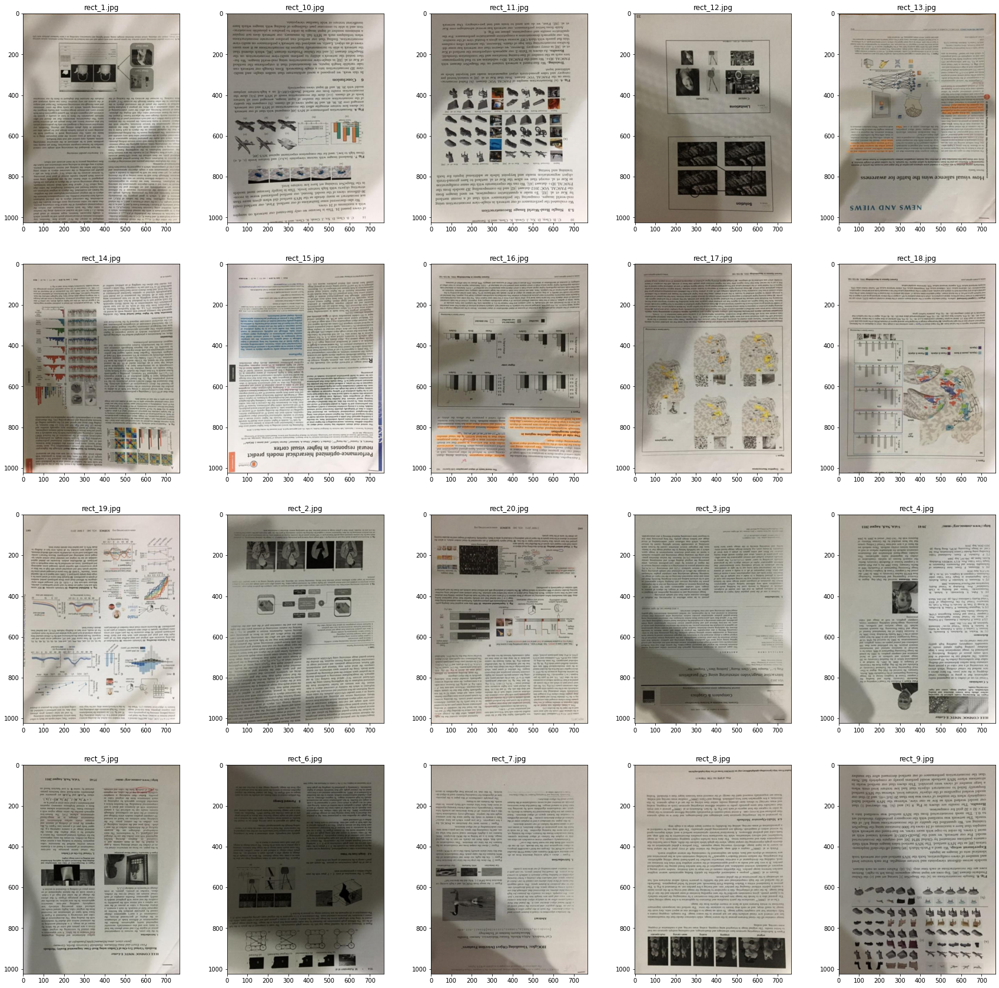

In [ ]:
figure = plt.figure(figsize = (6*5, 6*5))

for idx, sample in enumerate(test_loader):
    plt.subplot(4, 5, idx+1)
    plt.title(sample['img_path'][0].split('/')[-1])
    plt.imshow(convert_show_image(sample["img"].clone().detach().cpu().numpy()))

# Output Shadow Removal Images

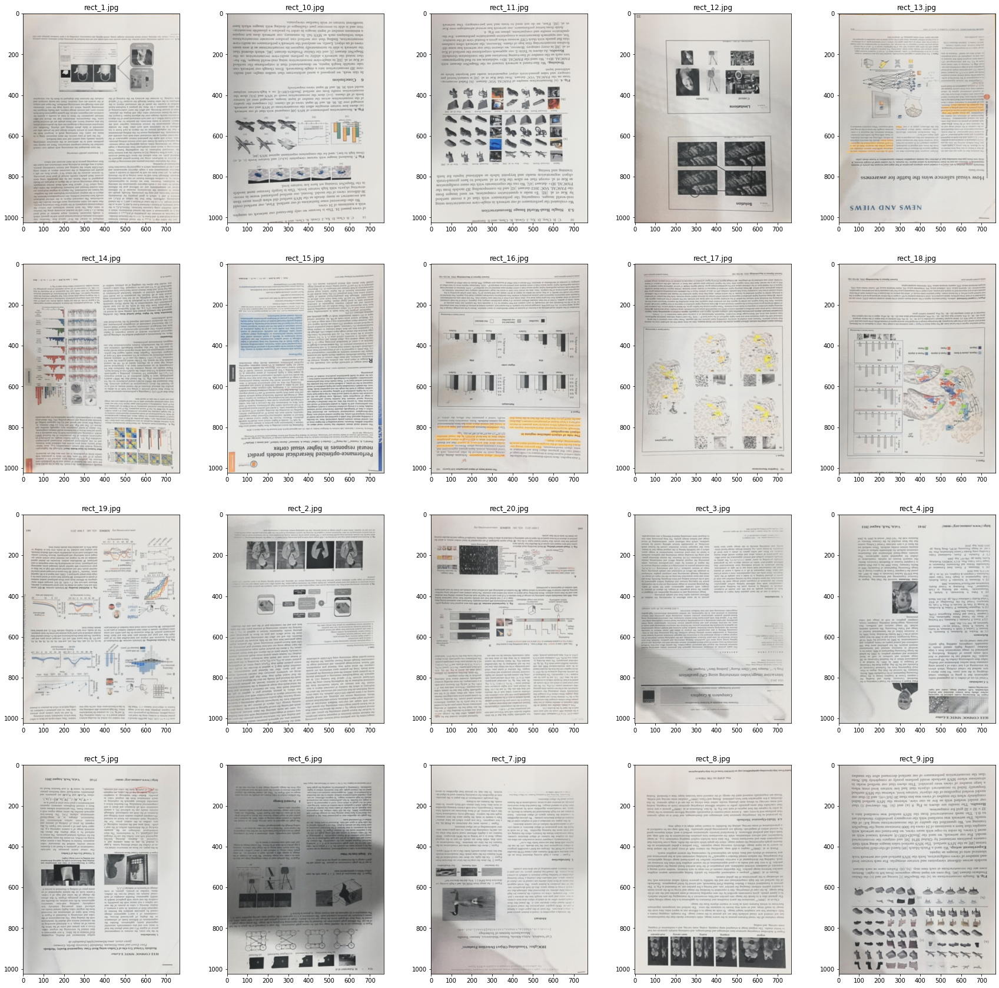

In [14]:
figure = plt.figure(figsize = (6*5, 6*5))

for idx, sample in enumerate(test_loader):
    plt.subplot(4, 5, idx+1)
    plt.title(sample['img_path'][0].split('/')[-1])
    plt.imshow(convert_show_image(np.array(preds), idx=idx))

# Ground Truth

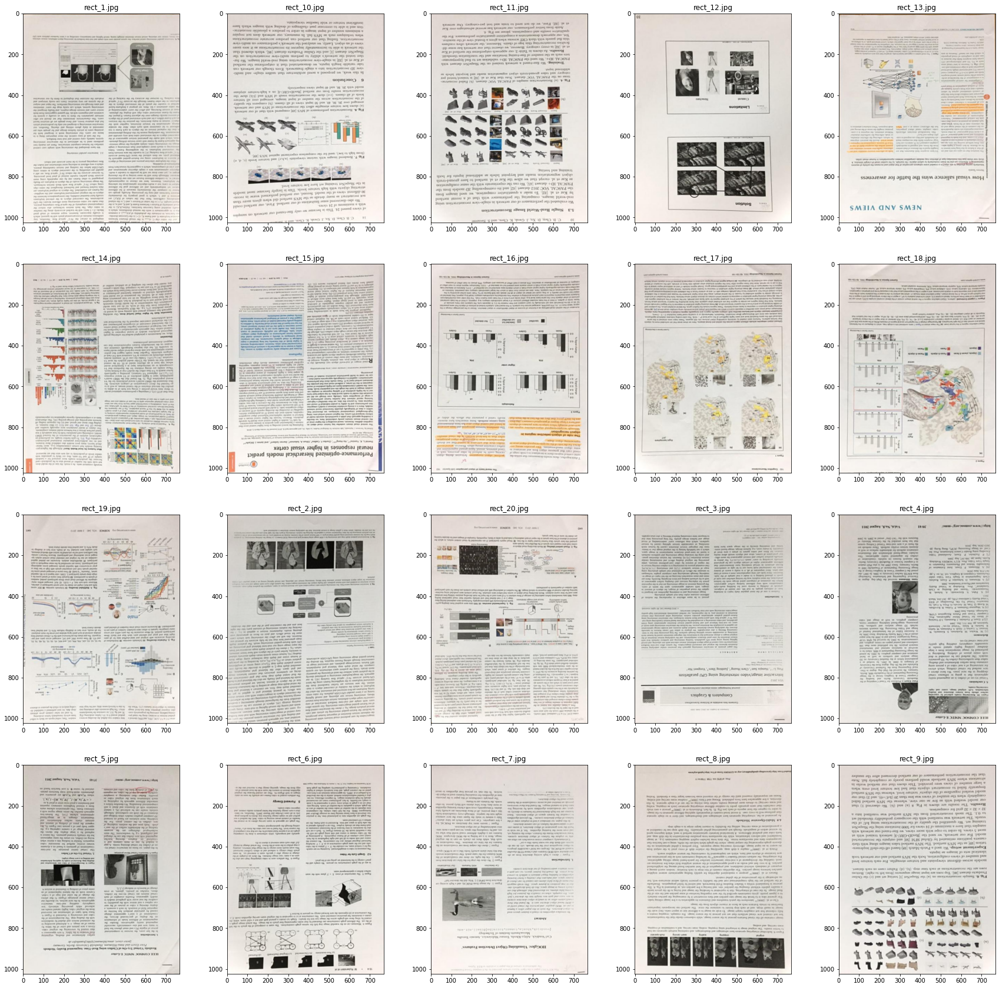

In [15]:
figure = plt.figure(figsize = (6*5, 6*5))

for idx, sample in enumerate(test_loader):
    plt.subplot(4, 5, idx+1)
    plt.title(sample['img_path'][0].split('/')[-1])
    plt.imshow(convert_show_image(np.array(gts), idx=idx))

# Attention Map from BE-Net

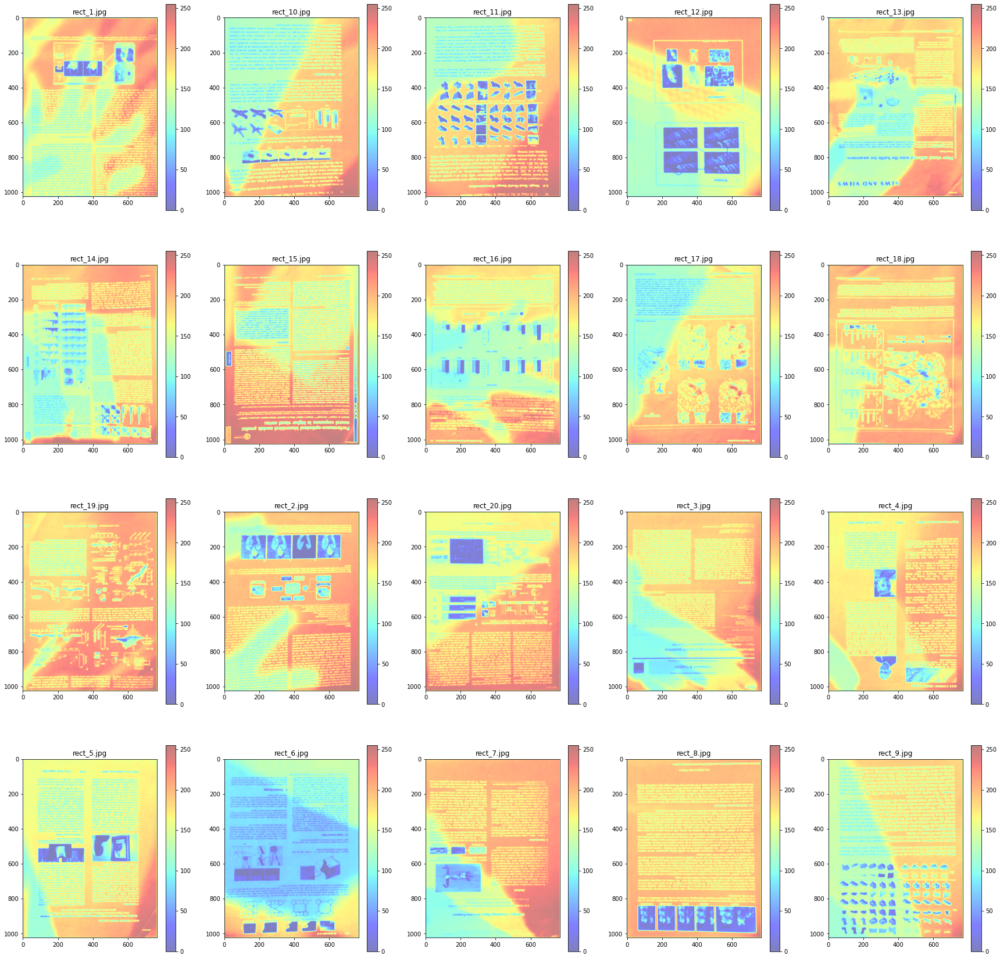

In [16]:
figure = plt.figure(figsize = (6*5, 6*5))

for idx, sample in enumerate(test_loader):
    plt.subplot(4, 5, idx+1)
    plt.title(sample['img_path'][0].split('/')[-1])
    plt.imshow(convert_show_image(np.array(attmaps), idx=idx), cmap='jet', alpha=0.5)
    plt.colorbar()

# Back Ground Color from BE-Net

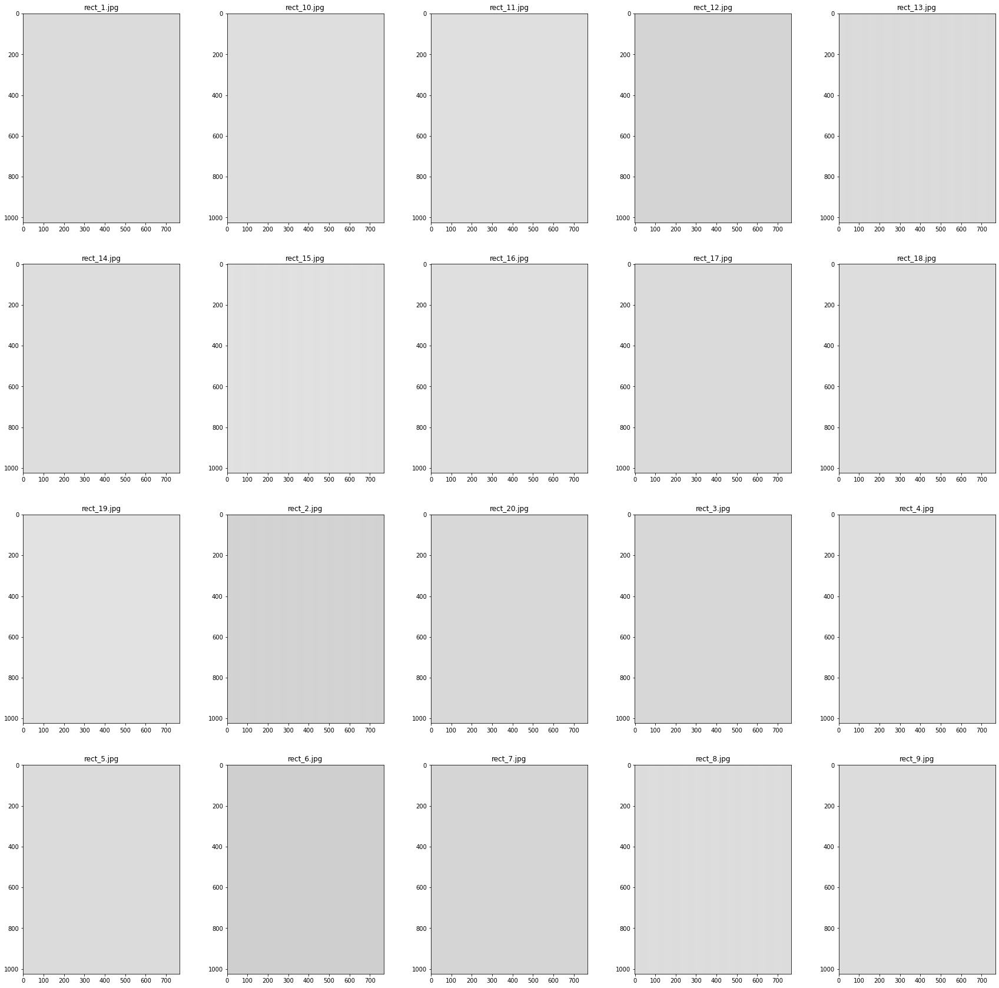

In [17]:
figure = plt.figure(figsize = (6*5, 6*5))

for idx, sample in enumerate(test_loader):
    plt.subplot(4, 5, idx+1)
    plt.title(sample['img_path'][0].split('/')[-1])
    plt.imshow(convert_show_image(np.array(bgcolors), idx=idx))

# Testing your own image

In [23]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [29]:
# you can put your own image path.
result_path = '../drive/MyDrive/shadow_removal_image.jpg'
image = cv2.imread("../drive/MyDrive/shadow_image.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
h, w, c = image.shape

tensor = test_transform(image=image)
tensor = tensor['image'].unsqueeze(0).to(device)

In [30]:
with torch.no_grad():

    with torch.set_grad_enabled(True):
        color, attmap, _ = benet(tensor)
        attmap = (attmap-0.5)/0.5
        back_color = torch.repeat_interleave(color.detach(), 1024*768, dim=0)
        back_ground = back_color.reshape(1, c, 1024, 768).to(device)

    input = torch.cat([tensor, attmap, back_ground], dim=1)

    tensor = tensor.detach().cpu()
    attmap = attmap.detach().cpu()
    back_ground = back_ground.detach().cpu()
    shadow_removal_image = generator(input).detach().cpu()


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/module.py:795: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


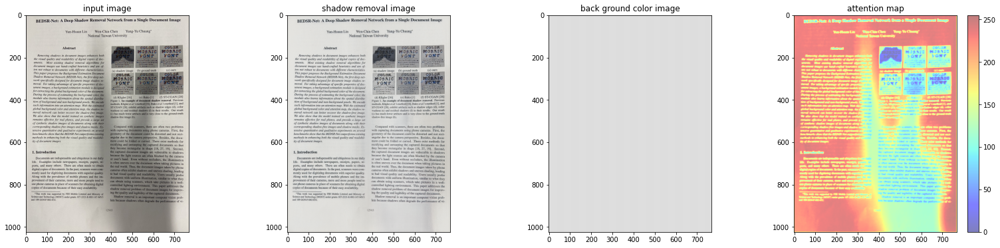

In [31]:
figure = plt.figure(figsize = (9*3, 2*3))
plt.subplot(1, 4, 1)
plt.title('input image')
plt.imshow(convert_show_image(tensor.clone().detach().cpu().numpy()))
plt.subplot(1, 4, 2)
plt.title('shadow removal image')
removal = convert_show_image(shadow_removal_image.clone().detach().cpu().numpy())
plt.imshow(removal)
plt.subplot(1, 4, 3)
plt.title('back ground color image')
plt.imshow(convert_show_image(back_ground.clone().detach().cpu().numpy()))
plt.subplot(1, 4, 4)
plt.title('attention map')
plt.imshow(convert_show_image(attmap.clone().detach().cpu().numpy()), cmap='jet', alpha=0.5)
plt.colorbar()
plt.show()

### saving result

In [32]:
if cv2.imwrite(result_path, cv2.cvtColor(removal, cv2.COLOR_RGB2BGR)):
  print("saved")

saved
